In [1]:
import functionsDENet as f
from IPython.display import Image
from IPython.core.display import HTML 

Pre set some parameters

In [2]:
#Where is the data table located
dataPath='/home/karin/Documents/timeTrajectories/data/'
#Where are results saved to and read from
dataPathSaved='/home/karin/Documents/timeTrajectories/data/correlations/replicates/'

#Data table layout info
tableLayout=dict()
tableLayout['rep']=dict()
tableLayout['single']=dict()
tableLayout['single']['lastGene']=12734
tableLayout['single']['Time']=12737
tableLayout['single']['Strain']=12736
tableLayout['rep']['lastGene']=12868
tableLayout['rep']['Time']=12870
tableLayout['rep']['Strain']=12869
#data=tableLayout['single']
data=tableLayout['rep']
genesFromRow=2

samples={
'AX4':[1,2,5,6,7,8,9],
'tagB':[1,2],
'comH':[1,2],
'tgrC1':[1,2],
'tgrB1':[1,2],
'tgrB1C1':[1,2],
'gbfA':[1,2],
}

geneDictInfo=('symbol','EntrezID','description')

#Option to pre-specify parameters

#repN=2
#rep='rep'+str(repN)
#rep=''
#repDict={'AX4_r1':1,'AX4_r2':2,'AX4_r5':5,'AX4_r6':6,'AX4_r7':7,'AX4_r8':8,'AX4_r9':9}
#strain='gbfA'

knnNeighbours=300
thresholdKNND=0.3
#Correlation r thershold
threshold = 0.80
#conditions=strain+'_'+rep+'kN'+str(knnNeighbours)+'T'+str(thresholdKNND)
thresholdRStr='Tr'+str(threshold).replace('.','_')

In [3]:
#Import data table and extract gene data
table=f.importTable(dataPath+'trans_9repAX4_6strains_2rep_avr_T12.tab')
#genes - table trimmed to contain only gene info, genes in columns
#genesNotNull - remove all 0 rows (genes in rows)
genes,genesNotNull=f.extractGenesFromTable(table,genesFromRow,data['lastGene'])

In [ ]:
#Import KNN results and display cosine distance distributions
#dist - distances for closest neighbours, neigh - closest neighbours
#inv - for distances when gene profiles are inversed to find negative correlations
#nGenesKnn - number of genes used in KNN
dist,neigh,distInv,neighInv,nGenesKnn=f.importKnnResults(dataPathSaved+strain+'_'+rep,knnNeighbours)
rows=nGenesKnn
#plot the distances distributions
f.plotKnnDist(dist,save=False)
f.plotKnnDist(distInv,save=False)

Example plots: comH rep1 KNN distances distribution and below the inverse distnaces. Each for 300 closest neighbours.
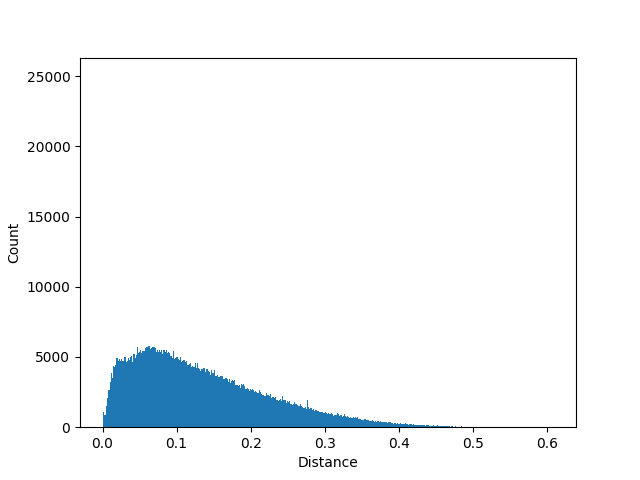
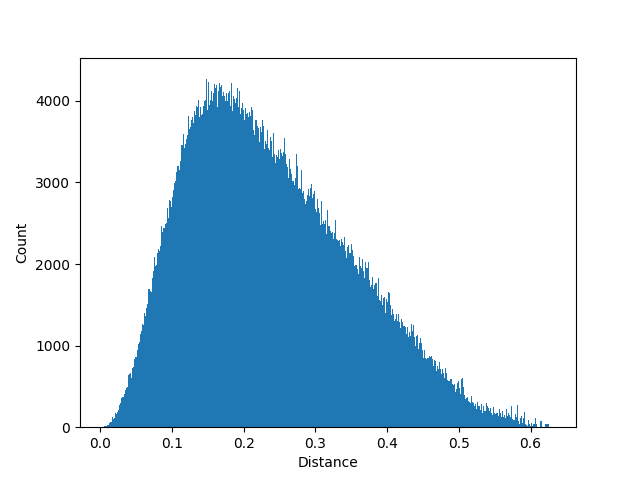

In [ ]:
#Load correlation results
pScoresS,rScoresS=f.loadCorrelationData(dataPathSaved+conditions)
#Plot correlation results
f.plotCorrelationR(rScoresS,save=False)

Example r score distribution (for tagB rep2)
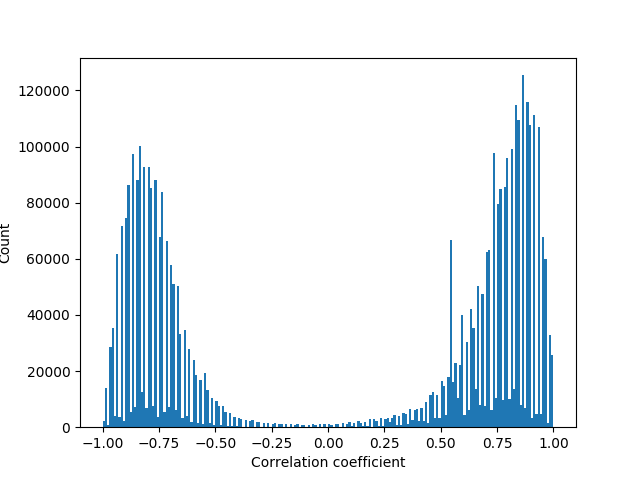

Create graphs:

To get correlations; for each sample separately:
1.) 300 nearest neighbours with cosine distance for normalised expression and inverse (*-1).
2.) For all pairs with distance <=0.3 calculate Spearman correlations.

To make graphs for each strain (add replicates on 1 graph), weight=abs(rho).
1.) Make multi graph for each strain (rho (correlation) thresh min abs(0.8)).
2.) Remove edges that were presenet in only 1 replicate (and remove isolates (nodes)).
3.) Merge into single edges, weight by average form replicates.
4.) Remove edges with weight below 0.95 (and isolates).
5.) Remove subNetworks with size below 4.

Merge graphs for all strains into multigraph. This created a single graph with 10187 nodes and 243530 edges.
If edges of this graph belonging to different strains are merged the graph has 228338 edges - most edges belong to single strain.

Example options for building the graphs
Check scriptDEnet.py for actual script

In [ ]:
#For building graph of replicates into strain graph
#Check 

#Add edges of replicates to strain MultiGraph
#Graph - multigraph of strain
#sampleStrain and replicate - identifiers of the replicate
#rScores - rScores (rho) dict
#threshold - min abs(r) to include in graph, 
#threshRorP - specify that threshold is for r (not p-value)
#genesWTN - genes used to calculate KNNs and r <- used for naming the indices in rScores dict
f.buildGraph(graph, sampleStrain, replicate, rScores, threshold, genesWTN,threshRorP=True, pScores='')
#Remove single sample/replicate edges from multigraph of a strain 
#(e.g. remove single edges)
f.removeSingleSampleEdges(graph)
#Merge  multi-edges of replicates to retain average weight single-edges
f.mergeReplicateEdges(graph)

In [ ]:
#Merge multiple strain graphs into single MultiGraph
#Label edges with strains
#Each g.. represents one strain graph object
graph=f.mergeGraphs([gAX4,gtagB,gcomH,gtgrC1,gtgrB1,gtgrB1C1,ggbfA])

Example of an expression profile (middle, from Orange) of a gene present in a netwrok observed in only 2 strains (top, as shown in Cytoscape). The strains constructing the network are tgrB1C1 and tgrB1 (as shown in legend on left in Cytoscape); expression of AX4 shown as comparison.
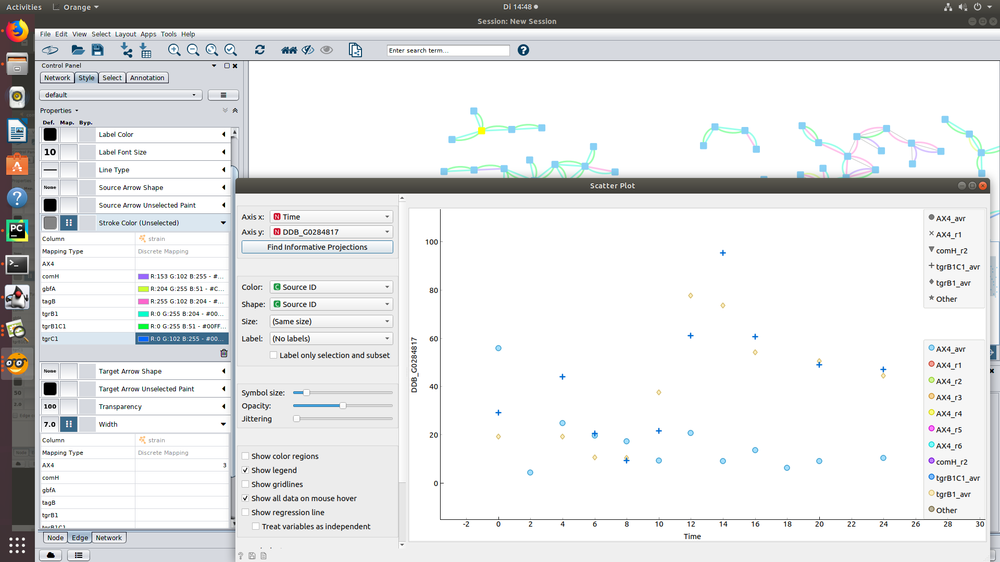

In [ ]:
#Build graph with lower r threshold from strains which will contain only edges present in all strains
#Itermediate is too big to be done as above
#Make r-score dicts list for all repl;icates of single strain named strainRdicts
#Keep only entries that were present in at least x strains with abs(r) above threshold
intersect=f.dictIntersectAvgVal(strainRdicts,presentInMin=x,minVal=threshold,useAbs=True)
#Add individual intersects of all strains to a list strainIntersectDicts
#Make new dict as above, specifiy that a association between 2 genes must be present in all 7 strains
#Note that creation of initial rScores dict ensures that gene names will be in right order in rScores keys for merging across strains and replicates
allStrains=f.dictIntersectAvgVal(strainIntersectDicts,7,threshold,True)

In [ ]:
#Make single edge graph from MultiGraph with summed edge weights
graphMerged=f.mergeStrainEdges(graph)

Examples of visualisations to analyse graph for prunning

Edge weights distribution

f.plotEdgeWeigths(graph,save=False)
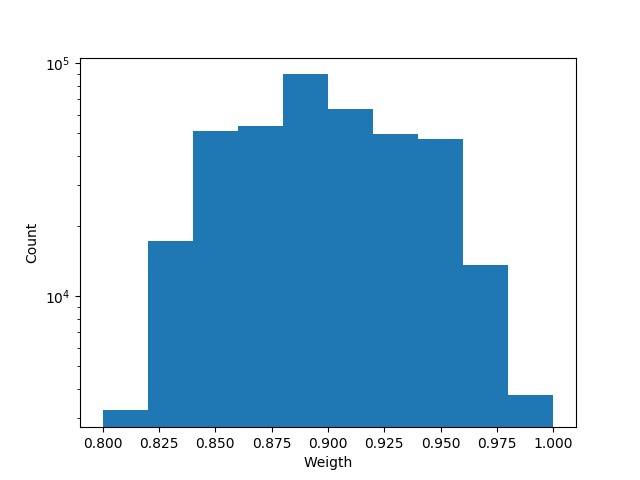

Sub graph sizes distribution example

f.plotSubgraphSize(graph,save=False)
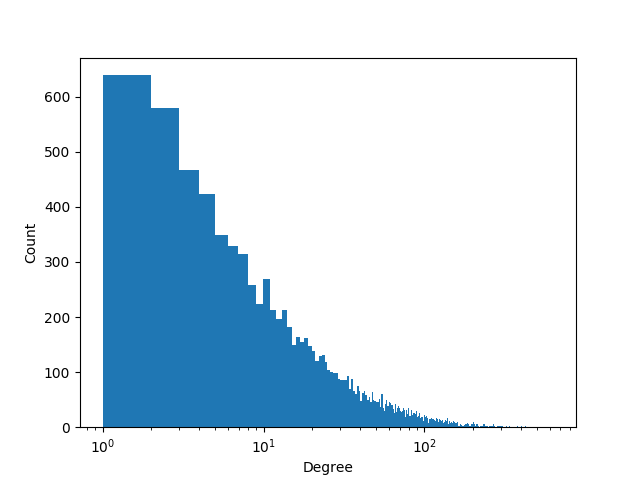

Distribution of node degrees

f.plotDegreeDist(graph,save=False)
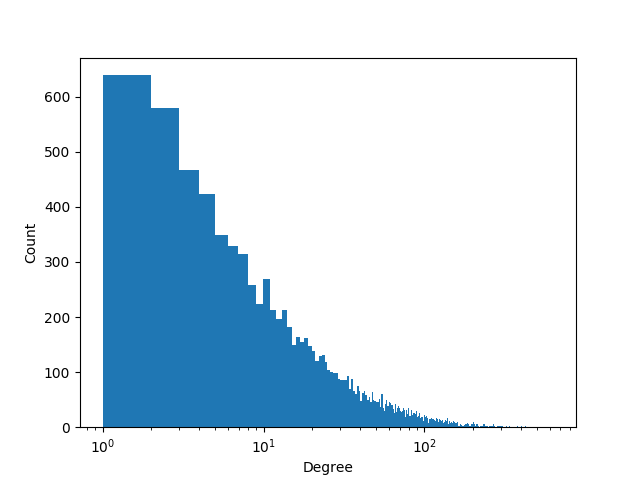

Number of remained edges after pruning for certain maximal node degree
f.plotEdgeNAfterDegreePruning(graph,save=False)
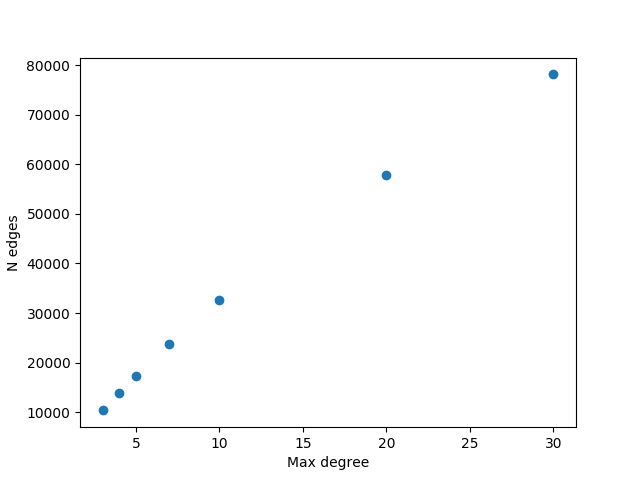

Prunning options:

In [ ]:
#Remove isolated edges
f.removeIsolates(graph)
#Remove sub-networks of size smaller than x
graph=f.removeSubNetsBelow(graph,x)
#Remove edges with weight below x
graph2=f.removeEdgesWeigth(graph,x)
#Remove edges not in at least x strains from multi strain MultiGraph
#Remove isolates and sub nets of smaller than y
graph=f.removeEdgeLessThanStrainsAndPrune(graph,minStrain=x,subNetsMin=y)
#Prune  graph (networkx Graph type) to have max x degree on each node
#Loop through nodes and retain best weights
#If multiple edges have same weight remove edges randomly
#This does not retain best weights for neighbours of nodes that are being pruned
f.pruneMaxDegree(graph,maxDegree=x)

Prune the graphs:
Create graph with min weight 0.97 (nodes: 8232, edges: 46618)  or 0.99 (nodes 2795, edges: 5863).

Network with min abs(r)=0.99 (as described above). Coloured by strains (legend on the left).
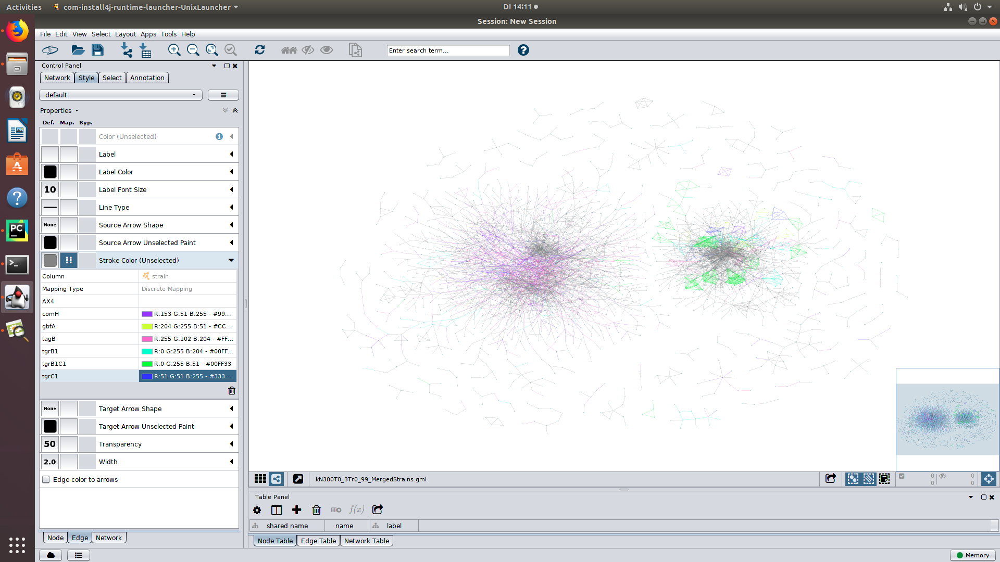


Graph with retained only edges in at least 2 strains (nodes 2561, edges 27433; if edges from more strains are merged to single edge there is 12401 edges)
 or 3 strains (nodes: 679, edges: 6417) or 7 strains -> no such edge.
Merge graph with at least 2 strains into single graph (sum weights), (nodes 2561, edges 12401).
Filter graph min 2 strains to min weight 0.97 (nodes: 455, edges 1553). (Eg. if 2 nodes were connected in 2 strains with w>=0.95 remove edges that have w<0.97 - should be vice versa -TODO).
After all of the above filters isolates and sub networks with size<4 were removed.

The graph with edge between 2 nodes if the connection was present in at least 2 strains is not separated well, but there is some evidence of network parts present in AX4-similar (AX4, comH, tagB) or developmentaly oscilating (tgrB1, tgrC1, tgrB1C1, gbfA) strains. The graph has many AX4 edges as there were more replicates. 

There is little gbfA connections. (Do not yet know why.) 

AX4
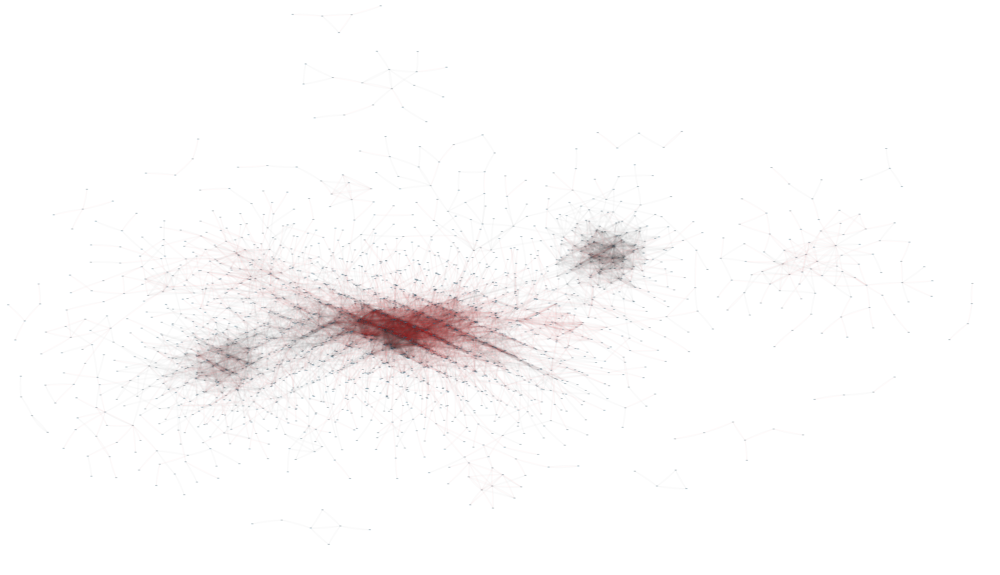
comH
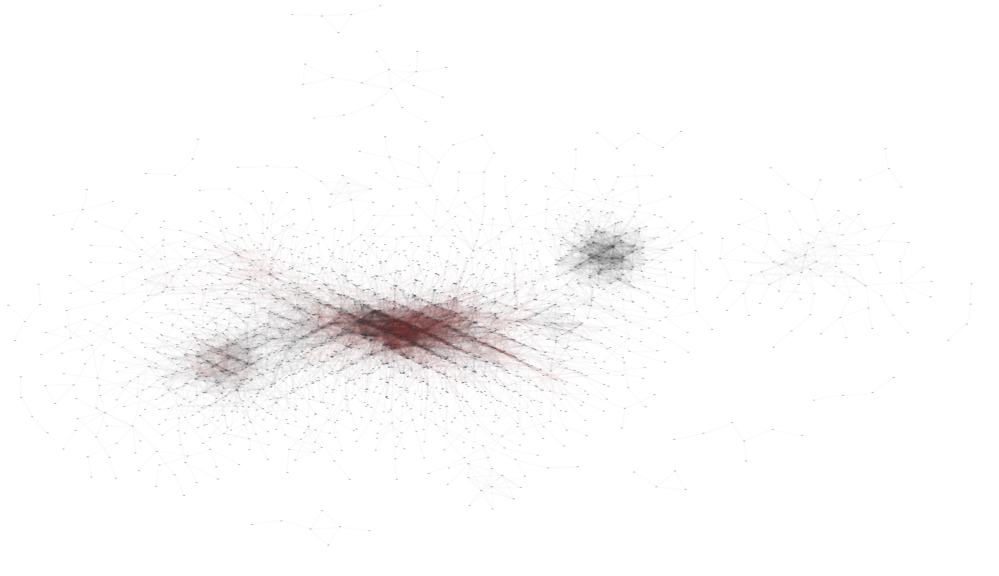
tagB
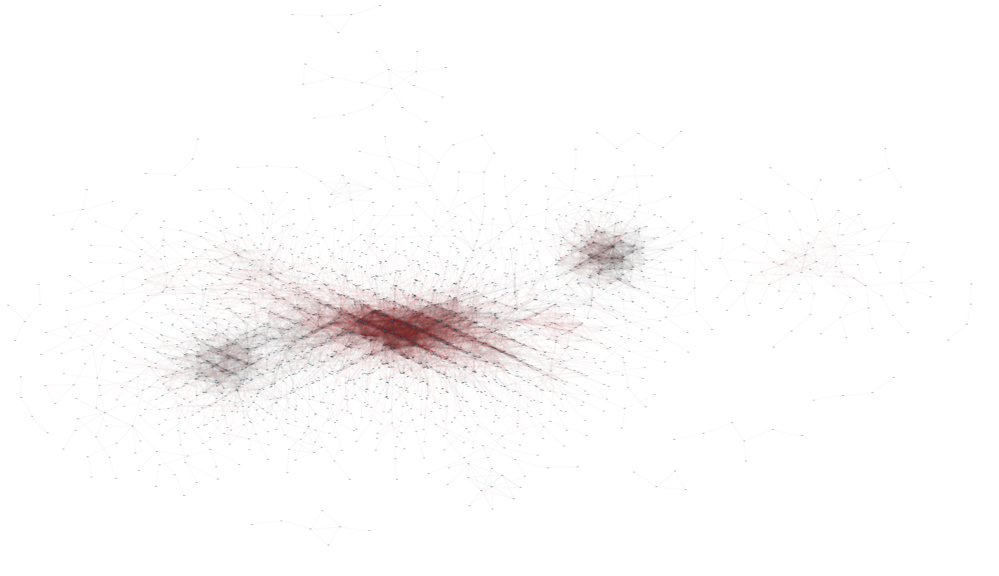

tgrC1
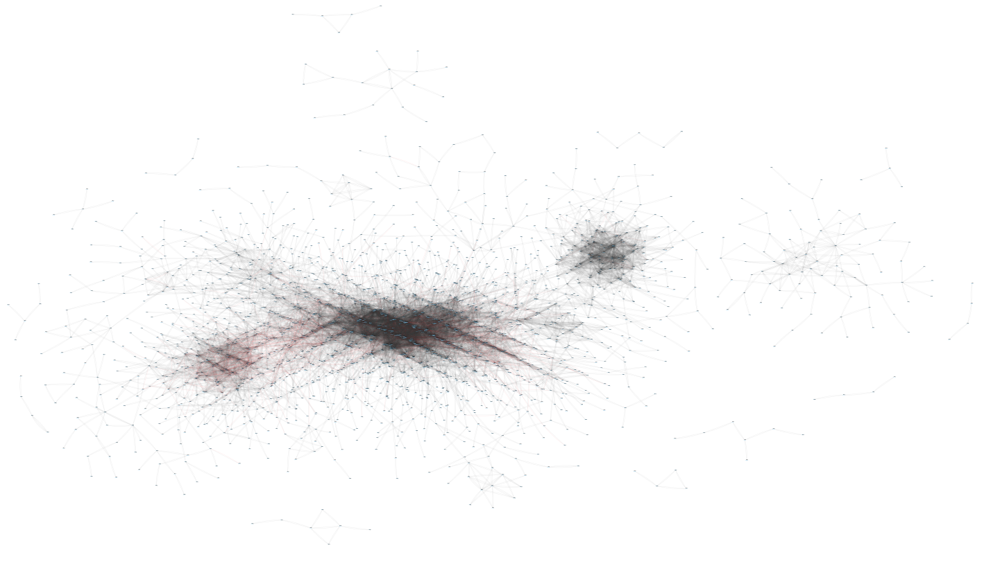
tgrB1C1
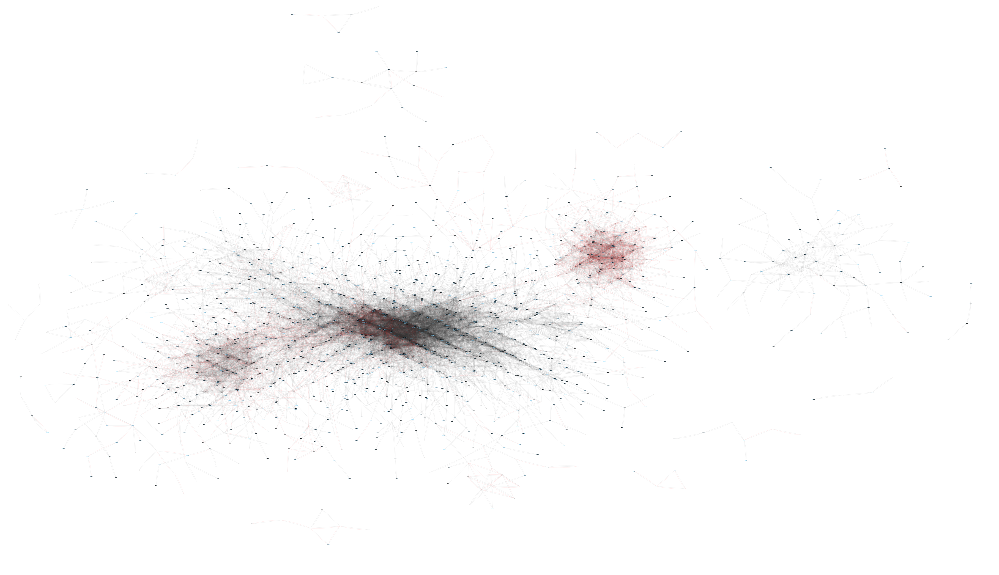
tgrB1
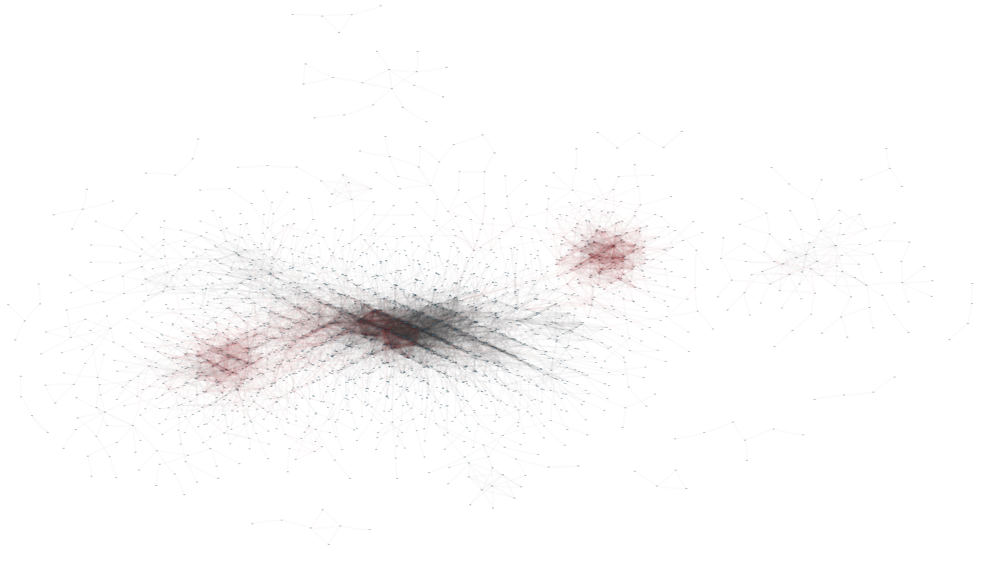
gbfA
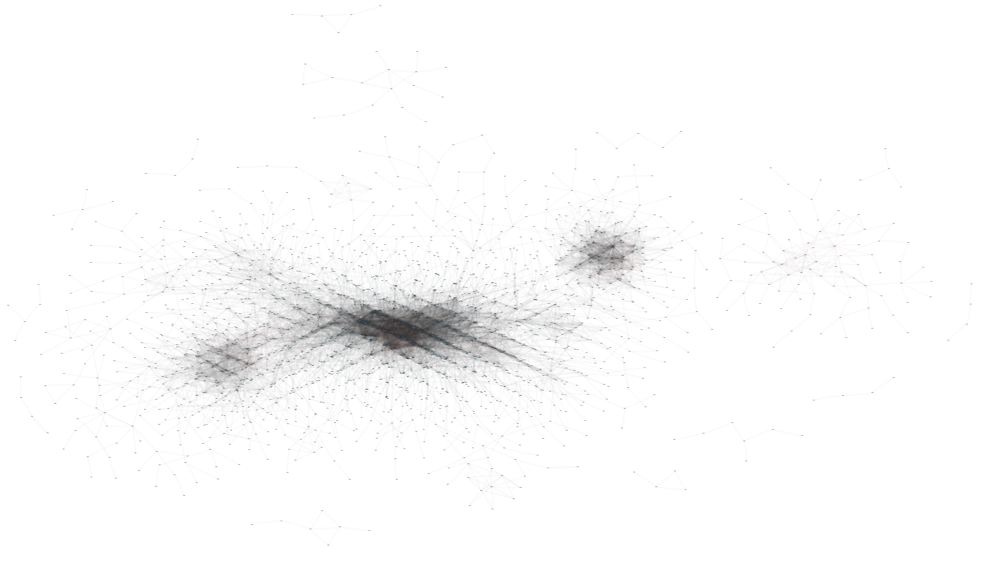

Prune graphs with removing edges from nodes with degree>d:
1.) Merge graphs from strains by summing strain weights.
2.) Remove edges from nodes that have degree>d
3.) Remove isolates and netwroks with number of nodes <4
If used on large graphs (filter r=0.95) a fur ball is created regardless of d (except when d=2 and graph is completely split up). If used on smaller graph (filter r=0.95, min 2 strain) the newly observed groups do not have good GO enrichment.

Furball (max degree 4)
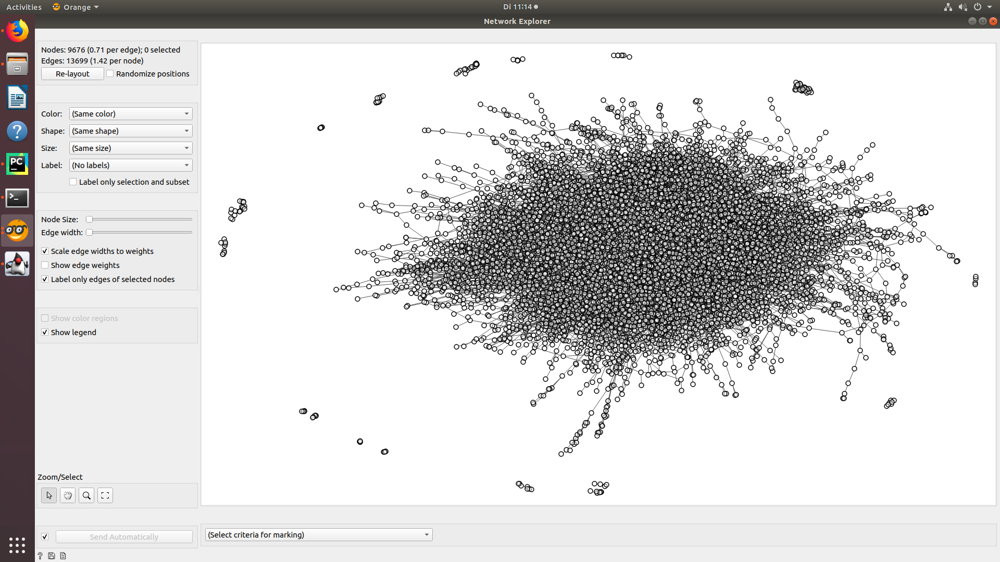

Orange TSNE of above data (based on all strains and averaged data). However, selecting groups for GO does not result in enrichment.
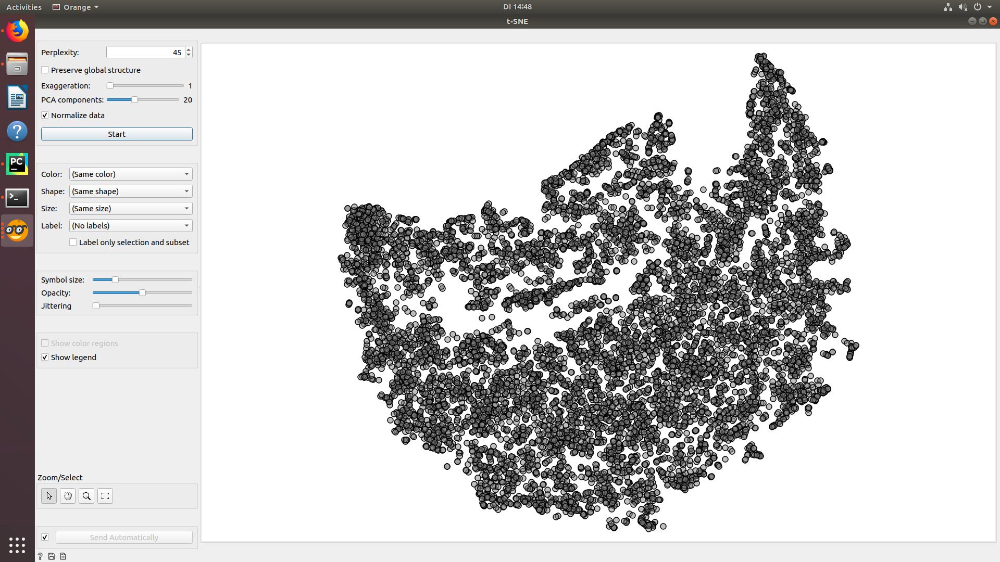

Too split up (max degree 2)
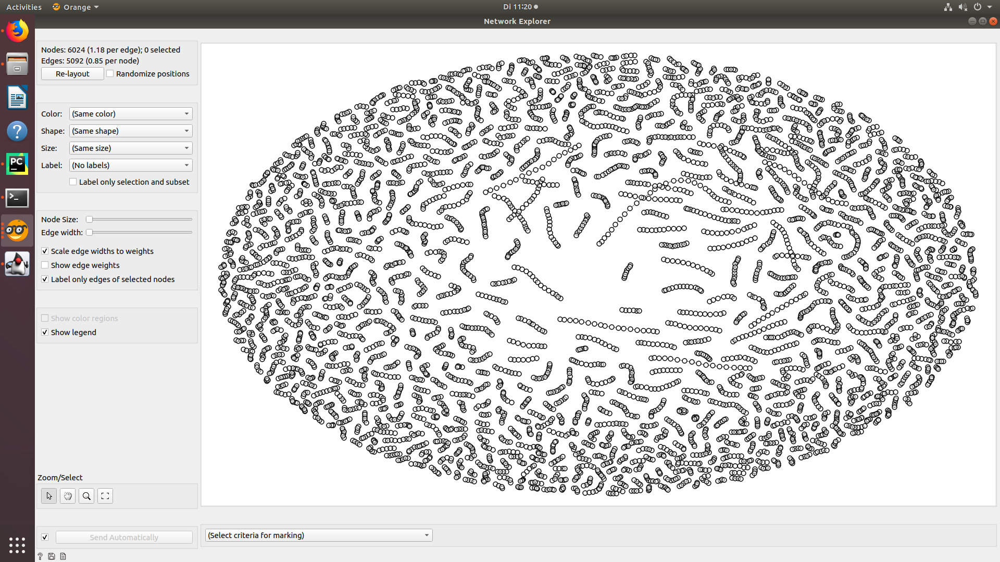

A smaller graph before degree pruning
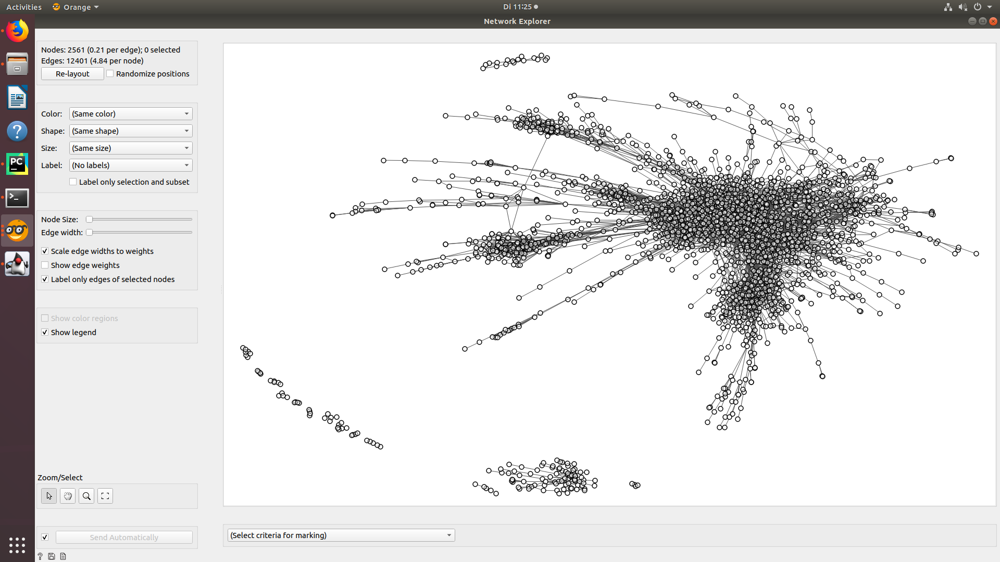

After pruning based on node degree
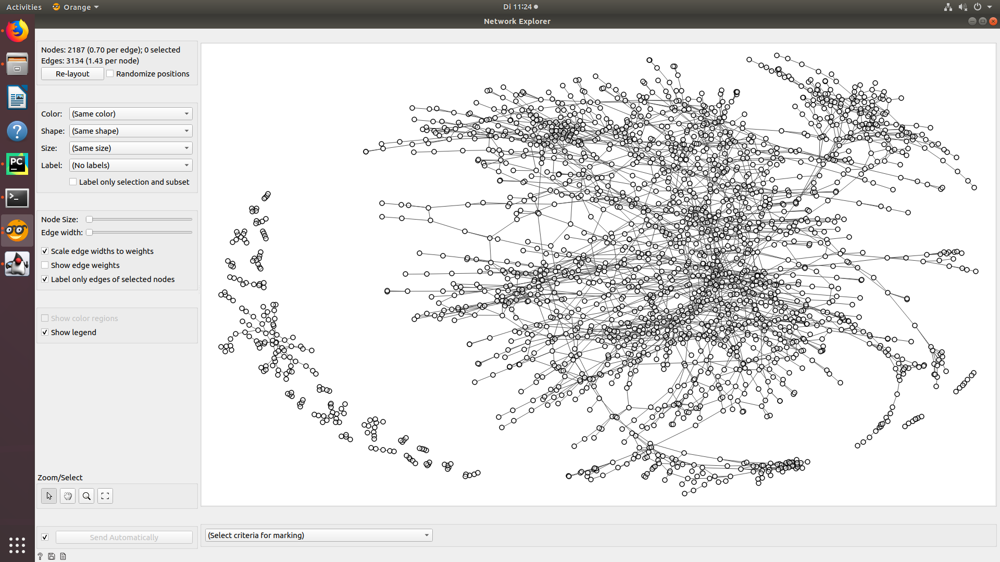

To make graphs with connections in all 7 strains allow lower r threashold when building the graph:
1.) For each strain: keep correlations that are present in at least 2 replicates with abs(r)>=0.8. Average these scores for each strain.
2.) Find connections that are present in all strains (form the strain averaged data).
3.) Create graph (non-multi Graph) with averages from strains weights (eg. strain averages) as weight. Nodes: 208, edges: 329.
If filter this by min weight=0.91 and remove isolates: nodes: 182, edges: 306.

In [ ]:
#Save genes from graph in tab format (complimentary data) for import in Orange
#genes,table, genesFromRow - objects as sepcified at top of script and in genes/table loading
#hasEntrez - does table contain Entrez ID as was in trans_erasure_7strains_for_orange.tab but not in trans_9repAX4_6strains_2rep_avr_T12.pkl
f.saveGenesForNet(graph,genes=genes,table=table,file=dataPathSaved+'graphName.tsv',dataFirstRow=genesFromRow,hasEntrez=False)

In [ ]:
#Annotate graph nodes
#Extract annotation for all gene DDB_IDs as present in all genes data
#Return dict k=DDB ID, val=(symbol, EntrezID,description) 
geneNames=f.matchDDBids(list(genes.columns))
#Label graph nodes with gene name dict (geneInfo):
#Graph muist have nodes named with DDB_IDs
#geneDictInfo specifies dict values structure, as specified at the top of script
f.labelNodesFromTuppleDict(graph,geneNames,geneDictInfo)
#Get GO annotation for sub-graph of a graph with nodes' attribute containing EntrezIDs
f.annSubsWithGO(graph,slims=False) #Annotates the existing graph


Example of a pruned network (edges present in at least 3 strains). Individual sub-networks were annotated with GO. When colouring nodes that were annotated with GO term containing 'actin' a sub netwrok of edges present mostly in AX4 similar strains is coloured (yellow nodes). 
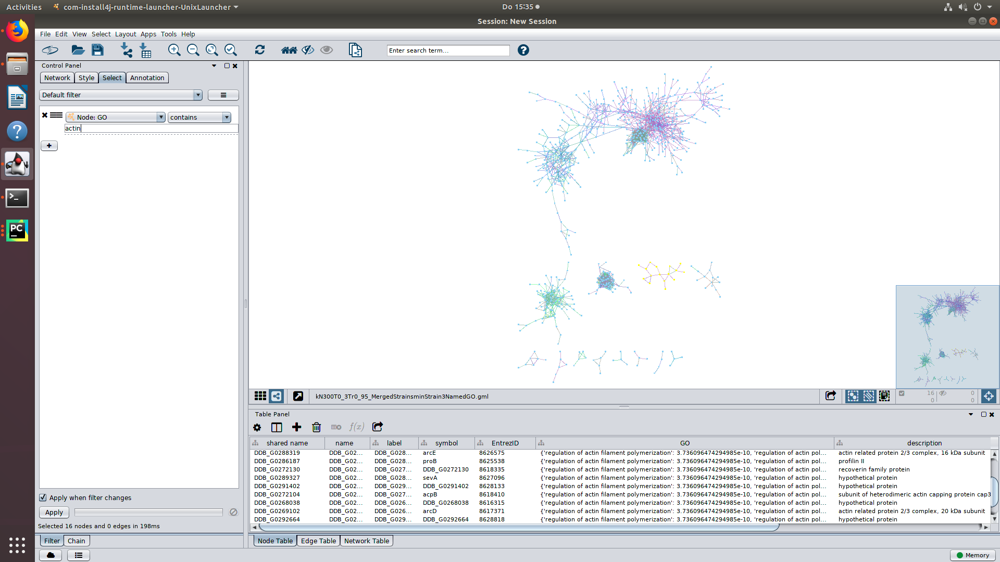